# ***Image Translation via Pix2Pix***

In [ ]:
# Generative Models Course (Fall 2024) | Sharif University of Technology (Iran)

AUTHOR_FNAME  =  "Maryam Rezaee"
AUTHOR_STDID  =  "402203089"

> **Reference Article:** [Image-to-Image Translation with Conditional Adversarial Networks by Isola et al. (2017)](https://arxiv.org/abs/1611.07004)

---

## **Introduction**

In recent years, **image-to-image translation** has emerged as a powerful tool for converting an image from one domain to another while preserving certain structural characteristics. Tasks like converting **semantic label maps** to **realistic images**, **day-to-night transformation**, or **edge-to-photo synthesis** all fall under this category.

One of the most influential works in this field is **Pix2Pix**, introduced by Isola et al. (2017). Pix2Pix is based on **conditional Generative Adversarial Networks (cGANs)**, where the model learns a mapping from input images to target images conditioned on paired data. It combines the **adversarial loss** from GANs with a **L1 reconstruction loss** to ensure both realistic outputs and fidelity to the input structure.

The main contributions of the Pix2Pix framework are:  
1. **Conditional GANs (cGANs):** GANs conditioned on input images to learn structured relationships.  
2. **Supervised Learning:** The use of paired datasets to guide image generation.  
3. **Versatility:** The framework can be applied to various tasks, such as semantic segmentation, object transfiguration, and style transfer.

This notebook demonstrates how to implement **Pix2Pix** for **semantic label-to-image translation** using the **Cityscapes dataset**, which is widely used for urban scene understanding tasks.


## **Modules & Config**

Before diving into the implementation, we begin by setting up the required environment. This includes loading necessary Python modules, setting a fixed random seed for reproducibility, defining the computational device (CPU/GPU), and mounting external storage for dataset access.

In [1]:
# Loading Modules

import torch
import torch.nn as nn
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, Dataset
import torch.optim as optim

import os
import time
from PIL import Image
import matplotlib.pyplot as plt
from tqdm.auto import tqdm

In [2]:
# Setting Config

torch.manual_seed(42)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Current device: {device}.")

Current device: cuda.


In [3]:
# Mounting Drive Folder

from google.colab import drive
drive.mount("/content/drive")

%cd drive/My Drive/Colab Notebooks/GM_HW3_Q5

Mounted at /content/drive
/content/drive/My Drive/Colab Notebooks/GM_HW3_Q5


### **Notes on Code**  
1. **Loading Modules**:  
   - `torch` and `torch.nn` are used for defining neural network architectures and training loops.  
   - `torchvision.transforms` handles data preprocessing, such as resizing and normalization.  
   - `DataLoader` and `Dataset` help load the Cityscapes dataset efficiently in batches.  
   - `optim` contains optimization algorithms like Adam.  
   - Additional libraries (`PIL`, `matplotlib`, `tqdm`) are used for image processing, visualization, and progress tracking.  

2. **Setting Config**:  
   - A fixed **random seed** (`42`) ensures that results are reproducible.  
   - `torch.device` automatically selects GPU if available; otherwise, it defaults to CPU.  

3. **Mounting Drive**:  
   - If you are running this code in Google Colab, the **Google Drive** is mounted for accessing the dataset and saving results.

## **Data Loading**

In this section, we load and preprocess the **Cityscapes Pix2Pix dataset**, which is available on [Kaggle](https://www.kaggle.com/datasets/balraj98/cityscapes-pix2pix-dataset/data). The dataset contains pairs of **segmented images** (semantic label maps) and their corresponding **real-world images**. Each pair is concatenated **horizontally** in a single image, where the left half is the real image, and the right half is the segmented image.

The dataset is organized into two main folders:  
- **`train`**: Training data  
- **`val`**: Validation data  

Both folders will be used for model training and evaluation.  

### **Installing and Downloading the Dataset**  

We use the Kaggle API to download the dataset. Ensure you have your `kaggle.json` API credentials ready and in the current directory before running the following commands. You may download that from your `Kaggle Account Settings > Create New API Key`.

In [4]:
# Installing and Loading Kaggle API

!pip install kaggle
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [5]:
# Downloading Cityescapes Pix2Pix Dataset

!kaggle datasets download -d balraj98/cityscapes-pix2pix-dataset
!unzip cityscapes-pix2pix-dataset.zip -d cityscapes_pix2pix_dataset

Dataset URL: https://www.kaggle.com/datasets/balraj98/cityscapes-pix2pix-dataset
License(s): other
 96% 97.0M/101M [00:01<00:00, 104MB/s] 
100% 101M/101M [00:01<00:00, 84.4MB/s]
Archive:  cityscapes-pix2pix-dataset.zip
  inflating: cityscapes_pix2pix_dataset/metadata.csv  
  inflating: cityscapes_pix2pix_dataset/train/1.jpg  
  inflating: cityscapes_pix2pix_dataset/train/10.jpg  
  inflating: cityscapes_pix2pix_dataset/train/100.jpg  
  inflating: cityscapes_pix2pix_dataset/train/1000.jpg  
  inflating: cityscapes_pix2pix_dataset/train/1001.jpg  
  inflating: cityscapes_pix2pix_dataset/train/1002.jpg  
  inflating: cityscapes_pix2pix_dataset/train/1003.jpg  
  inflating: cityscapes_pix2pix_dataset/train/1004.jpg  
  inflating: cityscapes_pix2pix_dataset/train/1005.jpg  
  inflating: cityscapes_pix2pix_dataset/train/1006.jpg  
  inflating: cityscapes_pix2pix_dataset/train/1007.jpg  
  inflating: cityscapes_pix2pix_dataset/train/1008.jpg  
  inflating: cityscapes_pix2pix_dataset/train/10

### **Creating a Custom Dataset Class**  

The **CityscapesDataset** class is created to:  
1. Read image pairs from the specified directory.  
2. Split each image into **segmented images** and **real images** (since they are concatenated horizontally).  
3. Apply transformations for resizing, normalization, and converting images to tensors.  

The PyTorch **Dataset** and **DataLoader** classes are used for efficient data management and loading.  


In [6]:
# Creating Dataset Class for Cityscapes (Pix2Pix)

class CityscapesDataset(Dataset):

    def __init__(self, data_dir, transform=None):

        self.data_dir = data_dir
        self.transform = transform
        self.files = sorted(os.listdir(self.data_dir))
        self.image_paths = []
        self.label_paths = []


    def __len__(self):

        return len(self.files)


    def __getitem__(self, idx):

        image_path = os.path.join(self.data_dir, self.files[idx])
        image = Image.open(image_path).convert("RGB")

        width, height = image.size
        real_image = image.crop((0, 0, width // 2, height))                     # due to data being concatenated horizontally
        segmented_image = image.crop((width //2, 0, width, height))             # due to data being concatenated horizontally

        if self.transform:
            real_image = self.transform(real_image)
            segmented_image = self.transform(segmented_image)

        return segmented_image, real_image


### **Transformations and Data Loaders**  

We define the following preprocessing pipeline:  
1. **Resize**: Images are resized to **256x256**.  
2. **Normalization**: Pixel values are normalized to the range **[-1, 1]** for better stability during GAN training.  
3. **ToTensor**: Converts images to PyTorch tensors.  

Using PyTorch **DataLoader**, we load batches of 32 images for training and validation.  

In [16]:
# Loading Cityscapes Pix2Pix Dataset

SIZE = 256
batch_size = 32
root_dir = "cityscapes_pix2pix_dataset"
train_dir = os.path.join(root_dir, 'train')
val_dir = os.path.join(root_dir, 'val')

data_transforms = transforms.Compose([
    transforms.Resize((SIZE, SIZE)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),                     # normalizing range (-1, 1)
])

train_dataset = CityscapesDataset(train_dir, transform=data_transforms)
val_dataset = CityscapesDataset(val_dir, transform=data_transforms)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2, persistent_workers=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=2, persistent_workers=True)


### **Visualizing the Data**  

To verify that the dataset has been loaded correctly, we display a few sample pairs of images side by side:  
- The **Input** is the segmented (semantic) image.  
- The **Target** is the corresponding real-world image.  

This visualization confirms that the images are preprocessed and loaded correctly, laying the groundwork for training the Pix2Pix model.

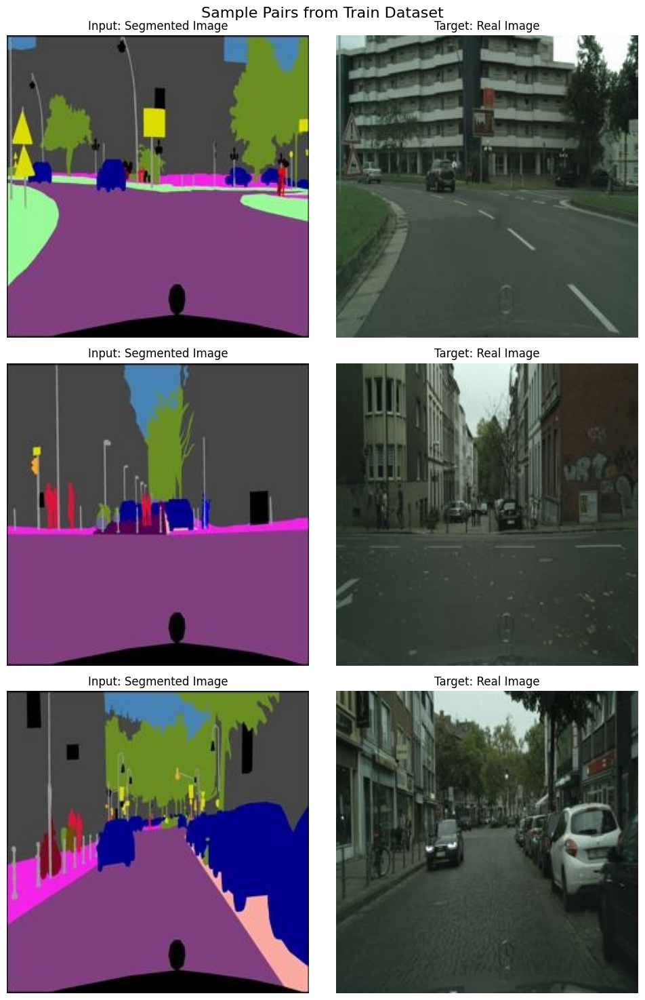

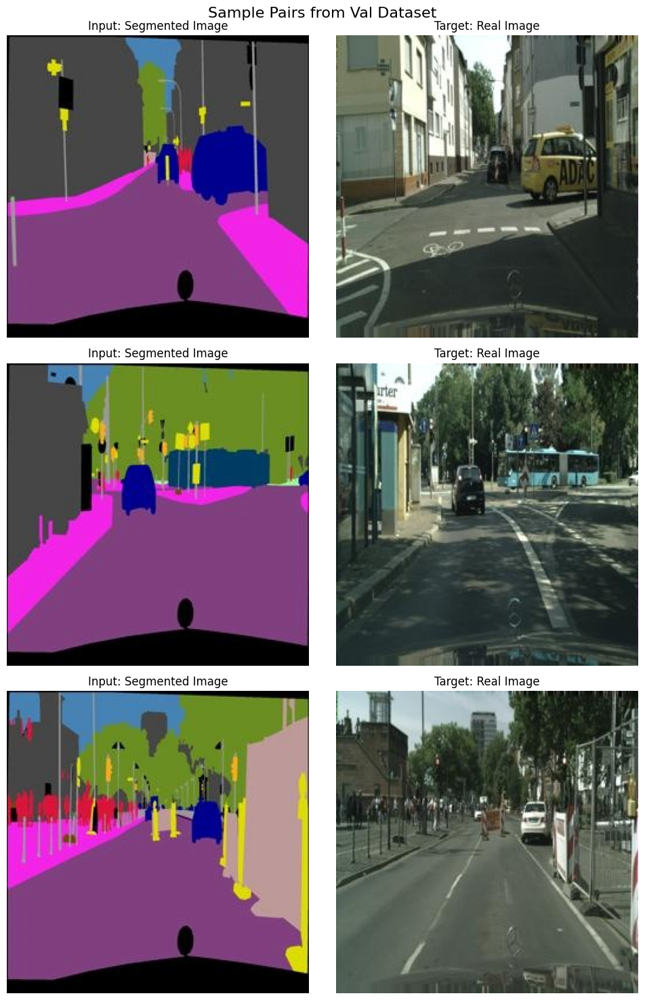

In [ ]:
# Displaying 3 Sample Pairs

def display_sample_pairs(dataset, num_pairs=10, title="Sample Pairs"):

    fig, axes = plt.subplots(num_pairs, 2, figsize=(10, 5 * num_pairs))
    fig.suptitle(title, fontsize=16)

    for i in range(num_pairs):
        segmented_image, real_image = dataset[i]
        segmented_image = segmented_image.permute(1, 2, 0) * 0.5 + 0.5          # denormalize for visualization
        real_image = real_image.permute(1, 2, 0) * 0.5 + 0.5                    # denormalize for visualization

        axes[i, 0].imshow(segmented_image)
        axes[i, 0].set_title("Input: Segmented Image")
        axes[i, 0].axis('off')
        axes[i, 1].imshow(real_image)
        axes[i, 1].set_title("Target: Real Image")
        axes[i, 1].axis('off')

    plt.tight_layout()
    plt.show()

display_sample_pairs(train_dataset, num_pairs=3, title="Sample Pairs from Train Dataset")
display_sample_pairs(val_dataset, num_pairs=3, title="Sample Pairs from Val Dataset")


## **Model Architecure**

As we mentioned before, the Pix2Pix model is a conditional generative adversarial network (cGAN) used for **image-to-image translation** tasks. Specifically, given a paired dataset, the Pix2Pix model can learn a mapping from an input image (e.g., a segmented image) to a target image (e.g., a realistic version of the scene) or vice versa. The model consists of two main components: a **Generator** and a **Discriminator**, trained adversarially using a specific combination of **adversarial loss** and **L1 loss**.

Below, we will explain each in more detail and proceed with implementation using various classes.

### **Pix2Pix Discriminator**

The discriminator in the Pix2Pix model is responsible for distinguishing between real and fake pairs of images (the input segmented image and its corresponding real image). Unlike traditional GANs, Pix2Pix uses a **PatchGAN** discriminator. Rather than outputting a single scalar prediction, the PatchGAN outputs a matrix of patch-level decisions.

#### **PatchGAN Concept**

PatchGAN evaluates whether overlapping **small patches** of the image are real or fake instead of analyzing the entire image at once. For instance, a **70x70 PatchGAN** discriminator (the choice for this implementation) evaluates all patches of size **70x70** from the input images, increasing spatial awareness and improving performance for high-resolution details.

#### **Architecture Overview**

The PatchGAN discriminator is a convolutional network consisting of successive layers that downsample the input image while increasing the depth of feature maps. The layers are as follows:

1. **Convolutional Layer:** Extracts features from the input image with 4x4 filters and stride 2.
2. **Leaky ReLU Activation:** Applies non-linearity with a slope of 0.2 for negative values.
3. **Batch Normalization:** Normalizes the activations to stabilize training.
4. **Final Convolution:** Produces a matrix of patch-level predictions.



#### **Layers Table**

<br/>

| Layer             | Output Shape                  | Kernel Size | Stride | Padding |
|--------------------|-------------------------------|-------------|--------|---------|
| Conv2D            | (batch_size, 64, H/2, W/2)    | 4x4         | 2      | 1       |
| LeakyReLU (0.2)   | (batch_size, 64, H/2, W/2)    | -           | -      | -       |
| Conv2D            | (batch_size, 128, H/4, W/4)   | 4x4         | 2      | 1       |
| BatchNorm2D       | (batch_size, 128, H/4, W/4)   | -           | -      | -       |
| LeakyReLU (0.2)   | (batch_size, 128, H/4, W/4)   | -           | -      | -       |
| Conv2D            | (batch_size, 256, H/8, W/8)   | 4x4         | 2      | 1       |
| BatchNorm2D       | (batch_size, 256, H/8, W/8)   | -           | -      | -       |
| LeakyReLU (0.2)   | (batch_size, 256, H/8, W/8)   | -           | -      | -       |
| Conv2D            | (batch_size, 512, H/8, W/8)   | 4x4         | 1      | 1       |
| BatchNorm2D       | (batch_size, 512, H/8, W/8)   | -           | -      | -       |
| LeakyReLU (0.2)   | (batch_size, 512, H/8, W/8)   | -           | -      | -       |
| Conv2D (Final)    | (batch_size, 1, H/8, W/8)     | 4x4         | 1      | 1       |
| Sigmoid           | (batch_size, 1, H/8, W/8)     | -           | -      | -       |

<br/>

### **Notes on Code**  

Below is the implementation of the above table. In short, the discriminator takes as input both the **segmented image** and the **real image**, concatenates them along the channel dimension, and outputs a **patch-level classification** verdict. It is assumed that the input channels are `3` (for an RGB image) but may be changed through differing inputs when instantiating the model.

In [17]:
# Defining Discriminator Class

class Discriminator(nn.Module):

    def __init__(self, in_channels=3):
        super(Discriminator, self).__init__()

        # helper function to construct layers quickly
        def conv_block(in_c, out_c, stride):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, kernel_size=4, stride=stride, padding=1),
                nn.BatchNorm2d(out_c),
                nn.LeakyReLU(0.2, inplace=True)
            )

        # due to concatenated input of segmented+real, in_channels=in_channels*2
        self.model = nn.Sequential(
            nn.Conv2d(in_channels*2, 64, kernel_size=4, stride=2, padding=1),     # C64, no BatchNorm
            nn.LeakyReLU(0.2, inplace=True),

            conv_block(64, 128, stride=2),                                        # C128
            conv_block(128, 256, stride=2),                                       # C256
            conv_block(256, 512, stride=1),                                       # C512 (stride 1 for 70x70 patches)

            nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=1),                # Final layer
            nn.Sigmoid()
        )


    def forward(self, x, y):

        concatenated = torch.cat([x, y], dim=1)
        verdict = self.model(concatenated)

        return verdict


### **Pix2Pix Generator**

The generator in the Pix2Pix model uses a **U-Net architecture** to produce realistic images (this is the general case, causing decoder layers to have increased dimensions from the usual transposed convlutions mirroring encder layers). U-Net is a type of convolutional neural network that consists of an **encoder-decoder structure** with skip connections. The encoder progressively downsamples the input image to extract features, while the decoder upsamples the features back to the original image resolution.

#### **Key Features of the U-Net Generator**

1. **Encoder:** The encoder extracts features by applying **convolutional layers** with stride 2, reducing the spatial dimensions while increasing the number of channels.
2. **Decoder:** The decoder uses **transpose convolutions** to increase the spatial dimensions of the feature maps back to the original size.
3. **Skip Connections:** Each layer `i` in the encoder is connected to the corresponding layer `n-i` in the decoder, where `n` is the total number of layers (to be precise, the skip connections concatenate activations from layer `i` to layer `n-i`), ensuring that fine-grained details from the input image are preserved during reconstruction.

#### **Architecture Overview**

The generator consists of:

- **DownSampling Layers:** Successive convolutional layers that downsample the input image while applying leaky ReLU activations and (optionally) batch normalization.
- **UpSampling Layers:** Transposed convolutional layers that upsample the feature maps. These layers also include skip connections, where the output of each upsampling layer is concatenated with the corresponding encoder output.
- **Final Layer:** A a convolution is applied to map to the number of output channels (3 in general, except in colorization, where it is 2), then a Tanh activation function ensures the output pixel values are scaled between -1 and 1.


#### **Encoder Layers**

<br/>

| Layer             | Output Shape                   | Kernel Size | Stride | Padding |
|--------------------|--------------------------------|-------------|--------|---------|
| Conv2D            | (batch_size, 64, H/2, W/2)     | 4x4         | 2      | 1       |
| LeakyReLU (0.2)   | (batch_size, 64, H/2, W/2)     | -           | -      | -       |
| Conv2D            | (batch_size, 128, H/4, W/4)    | 4x4         | 2      | 1       |
| BatchNorm2D       | (batch_size, 128, H/4, W/4)    | -           | -      | -       |
| LeakyReLU (0.2)   | (batch_size, 128, H/4, W/4)    | -           | -      | -       |
| Conv2D            | (batch_size, 256, H/8, W/8)    | 4x4         | 2      | 1       |
| BatchNorm2D       | (batch_size, 256, H/8, W/8)    | -           | -      | -       |
| LeakyReLU (0.2)   | (batch_size, 256, H/8, W/8)    | -           | -      | -       |
| Conv2D            | (batch_size, 512, H/16, W/16)  | 4x4         | 2      | 1       |
| BatchNorm2D       | (batch_size, 512, H/16, W/16)  | -           | -      | -       |
| LeakyReLU (0.2)   | (batch_size, 512, H/16, W/16)  | -           | -      | -       |
| Conv2D            | (batch_size, 512, H/32, W/32)  | 4x4         | 2      | 1       |
| BatchNorm2D       | (batch_size, 512, H/32, W/32)  | -           | -      | -       |
| LeakyReLU (0.2)   | (batch_size, 512, H/32, W/32)  | -           | -      | -       |
| Conv2D            | (batch_size, 512, H/64, W/64)  | 4x4         | 2      | 1       |
| BatchNorm2D       | (batch_size, 512, H/64, W/64)  | -           | -      | -       |
| LeakyReLU (0.2)   | (batch_size, 512, H/64, W/64)  | -           | -      | -       |
| Conv2D            | (batch_size, 512, H/128, W/128)| 4x4         | 2      | 1       |
| LeakyReLU (0.2)   | (batch_size, 512, H/128, W/128)| -           | -      | -       |

<br/>

#### **Decoder Layers**

<br/>

| Layer               | Output Shape                   | Kernel Size | Stride | Padding |
|----------------------|--------------------------------|-------------|--------|---------|
| ConvTranspose2D      | (batch_size, 512, H/64, W/64) | 4x4         | 2      | 1       |
| BatchNorm2D          | (batch_size, 512, H/64, W/64) | -           | -      | -       |
| ReLU                 | (batch_size, 512, H/64, W/64) | -           | -      | -       |
| Skip Connection      | Concatenate with Encoder      | -           | -      | -       |
| ConvTranspose2D      | (batch_size, 512, H/32, W/32) | 4x4         | 2      | 1       |
| BatchNorm2D          | (batch_size, 512, H/32, W/32) | -           | -      | -       |
| ReLU                 | (batch_size, 512, H/32, W/32) | -           | -      | -       |
| Skip Connection      | Concatenate with Encoder      | -           | -      | -       |
| ConvTranspose2D      | (batch_size, 512, H/16, W/16) | 4x4         | 2      | 1       |
| BatchNorm2D          | (batch_size, 512, H/16, W/16) | -           | -      | -       |
| ReLU                 | (batch_size, 512, H/16, W/16) | -           | -      | -       |
| Skip Connection      | Concatenate with Encoder      | -           | -      | -       |
| ConvTranspose2D      | (batch_size, 512, H/8, W/8)   | 4x4         | 2      | 1       |
| BatchNorm2D          | (batch_size, 512, H/8, W/8)   | -           | -      | -       |
| ReLU                 | (batch_size, 512, H/8, W/8)   | -           | -      | -       |
| Skip Connection      | Concatenate with Encoder      | -           | -      | -       |
| ConvTranspose2D      | (batch_size, 256, H/4, W/4)   | 4x4         | 2      | 1       |
| BatchNorm2D          | (batch_size, 256, H/4, W/4)   | -           | -      | -       |
| ReLU                 | (batch_size, 256, H/4, W/4)   | -           | -      | -       |
| Skip Connection      | Concatenate with Encoder      | -           | -      | -       |
| ConvTranspose2D      | (batch_size, 128, H/2, W/2)   | 4x4         | 2      | 1       |
| BatchNorm2D          | (batch_size, 128, H/2, W/2)   | -           | -      | -       |
| ReLU                 | (batch_size, 128, H/2, W/2)   | -           | -      | -       |
| Skip Connection      | Concatenate with Encoder      | -           | -      | -       |
| ConvTranspose2D      | (batch_size, 64, H, W)        | 4x4         | 2      | 1       |
| BatchNorm2D          | (batch_size, 64, H, W)        | -           | -      | -       |
| ReLU                 | (batch_size, 64, H, W)        | -           | -      | -       |
| ConvTranspose2D      | (batch_size, 3, H, W)         | 4x4         | 2      | 1       |
| Tanh                 | (batch_size, 3, H, W)         | -           | -      | -       |

<br/>

### **Notes on Code**  

To implement the above tables, we will define a class DownSample and a class UpSample and finally a class Generator to use the aforementioned two classes and form the U-Net design. It is assumed that the target dimensions are `3` for the general case, but the model inputs allow for a different choice of output channel count.

In [18]:
# Defining Generator Class (via DownSample and UpSample Classes)

class DownSample(nn.Module):

    def __init__(self, in_channels, out_channels, apply_batchnorm=True):
        super(DownSample, self).__init__()

        layers = [
            nn.Conv2d(in_channels, out_channels, kernel_size=4, stride=2, padding=1, bias=not(apply_batchnorm))]
        if apply_batchnorm:
            layers.append(nn.BatchNorm2d(out_channels))
        layers.append(nn.LeakyReLU(0.2, inplace=True))

        self.down = nn.Sequential(*layers)


    def forward(self, x):

        return self.down(x)


class UpSample(nn.Module):
    def __init__(self, in_channels, out_channels, apply_dropout=False):
        super(UpSample, self).__init__()

        layers = [
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        ]
        if apply_dropout:
            layers.append(nn.Dropout(0.5))

        self.up = nn.Sequential(*layers)


    def forward(self, x, skip):

        x = self.up(x)
        x = torch.cat([x, skip], dim=1)                                         # skip connection
        return x


class Generator(nn.Module):

    def __init__(self, in_channels=3, out_channels=3):
        super(Generator, self).__init__()

        # Encoder (DownSampling)
        self.down1 = DownSample(in_channels, 64, apply_batchnorm=False)         # C64
        self.down2 = DownSample(64, 128)                                        # C128
        self.down3 = DownSample(128, 256)                                       # C256
        self.down4 = DownSample(256, 512)                                       # C512
        self.down5 = DownSample(512, 512)                                       # C512
        self.down6 = DownSample(512, 512)                                       # C512
        self.down7 = DownSample(512, 512)                                       # C512
        self.down8 = DownSample(512, 512)                                       # C512

        # Decoder (Upsampling)
        self.up1 = UpSample(512, 512, apply_dropout=True)                       # CD512
        self.up2 = UpSample(1024, 512, apply_dropout=True)                      # CD1024
        self.up3 = UpSample(1024, 512, apply_dropout=True)                      # CD1024
        self.up4 = UpSample(1024, 512)                                          # C1024
        self.up5 = UpSample(1024, 256)                                          # C1024
        self.up6 = UpSample(512, 128)                                           # C512
        self.up7 = UpSample(256, 64)                                            # C256

        self.final = nn.Sequential(
            nn.ConvTranspose2d(128, out_channels, kernel_size=4, stride=2, padding=1),
            nn.Tanh()
        )


    def forward(self, x):

        # Encoder forward
        d1 = self.down1(x)
        d2 = self.down2(d1)
        d3 = self.down3(d2)
        d4 = self.down4(d3)
        d5 = self.down5(d4)
        d6 = self.down6(d5)
        d7 = self.down7(d6)
        d8 = self.down8(d7)

        # Decoder forward + skip connections (U-Net)
        u1 = self.up1(d8, d7)
        u2 = self.up2(u1, d6)
        u3 = self.up3(u2, d5)
        u4 = self.up4(u3, d4)
        u5 = self.up5(u4, d3)
        u6 = self.up6(u5, d2)
        u7 = self.up7(u6, d1)

        return self.final(u7)


### **Pix2Pix Model**

The Pix2Pix model combines the generator and discriminator to form a conditional GAN framework. During training, the generator learns to "fool" the discriminator, while the discriminator improves at identifying real vs. fake image pairs.

#### **Loss Functions**

The Pix2Pix model uses two key loss components:

1. **Adversarial Loss (GAN Loss):**
   This loss encourages the generator to produce images that are indistinguishable from real images. It uses the **binary cross-entropy loss** for real vs. fake classification:

   $$
   \mathcal{L}_{GAN}(G, D) = \mathbb{E}_{x, y}[\log D(x, y)] + \mathbb{E}_{x}[\log (1 - D(x, G(x)))]
   $$

   Where:
   - \( $G$ \) is the generator.
   - \( $D$ \) is the discriminator.
   - \( $x$ \) is the input (segmented) image.
   - \( $y$ \) is the real (target) image.


2. **L1 Loss:**
   To ensure that the generated images are not only realistic but also structurally similar to the target images, an **L1 loss** is applied:

   $$
   \mathcal{L}_{L1}(G) = \mathbb{E}_{x, y} \| y - G(x) \|_1
   $$

   The L1 loss penalizes large pixel-level differences between the generated image \( $G(x)$ \) and the real image \( $y$ \).

#### **Total Generator Loss**

The total loss for the generator combines the GAN loss and the L1 loss:

$$
\mathcal{L}_{Generator} = \mathcal{L}_{GAN} + \lambda \cdot \mathcal{L}_{L1}
$$

Here, \( $\lambda$ \) is a scaling factor (e.g., \( $\lambda = 100$ \)) that balances the adversarial loss and the L1 loss.

#### **Discriminator Loss**

The discriminator's loss measures its ability to distinguish real image pairs from fake ones. The loss is calculated as the average of two binary cross-entropy terms:

$$
\mathcal{L}_{Discriminator} = \frac{1}{2} \left( \mathcal{L}_{real} + \mathcal{L}_{fake} \right)
$$

Where:
- \( $\mathcal{L}_{real}$ \) is the loss for real pairs: \( $D(x, y) \rightarrow 1$ \).
- \( $\mathcal{L}_{fake}$ \) is the loss for fake pairs: \( $D(x, G(x)) \rightarrow 0$ \).

<br/>

#### **Notes on Code**

Based on the above theory, we will now implement the full PixPix model using the previous classes and define each cost function for later use on received segmented images for generating coresponding real images.

In [19]:
# Defining Pix2Pix Model Class and Cost Functions

class Pix2Pix(nn.Module):

    def __init__(self, generator, discriminator):
        super(Pix2Pix, self).__init__()

        self.generator = generator
        self.discriminator = discriminator
        self.criterion_gan = nn.BCEWithLogitsLoss()
        self.criterion_l1 = nn.L1Loss()


    def generator_loss(self, fake_output, fake_target, real_target, lambda_l1=100):

        adversarial_loss = self.criterion_gan(fake_output, torch.ones_like(fake_output, device=fake_output.device))
        l1_loss = self.criterion_l1(fake_target, real_target)

        total_loss = adversarial_loss + lambda_l1 * l1_loss
        return total_loss


    def discriminator_loss(self, real_output, fake_output):

        real_loss = self.criterion_gan(real_output, torch.ones_like(real_output, device=real_output.device))
        fake_loss = self.criterion_gan(fake_output, torch.zeros_like(fake_output, device=fake_output.device))

        total_loss = (real_loss + fake_loss) * 0.5
        return total_loss


## **Model Instantiation**

To instantiate the Pix2Pix model, we combine the previously defined Generator and Discriminator. The Generator is responsible for generating real-like images from input segmented images, while the Discriminator evaluates whether the generated images are real or fake. Both models are moved to the appropriate computation device (e.g., GPU for faster processing).

In [20]:
# Instantiating Pix2Pix Model

generator = Generator().to(device)
discriminator = Discriminator().to(device)
pix2pix = Pix2Pix(generator, discriminator).to(device)

print(pix2pix)

Pix2Pix(
  (generator): Generator(
    (down1): DownSample(
      (down): Sequential(
        (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
        (1): LeakyReLU(negative_slope=0.2, inplace=True)
      )
    )
    (down2): DownSample(
      (down): Sequential(
        (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): LeakyReLU(negative_slope=0.2, inplace=True)
      )
    )
    (down3): DownSample(
      (down): Sequential(
        (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): LeakyReLU(negative_slope=0.2, inplace=True)
      )
    )
    (down4): DownSample(
      (down): Sequential(
        (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    

### **Model Hyperparameters**

1. <font color="92bee0">**Generator Dropout Rate**</font>

  - **Value:** `0.5` (in `up1`, `up2`, and `up3` layers)

  - **Explanation:** By randomly deactivating a percentage of the neurons, dropout helps prevent overfitting and improves generalization, especially during the upsampling process where the Generator reconstructs fine-grained details. Matching the reference article of Pix2Pix, this implementation utilizes dropout with a rate of `50%` in the middle layers for a balanced injection of randomness, to ensure sufficient regularization without disrupting the overall flow.


2. <font color="92bee0">**Lambda L1**</font>

  - **Value:** `100`

  - **Explanation:** `lambda_l1` controls the balance between the adversarial loss and the L1 pixel loss in the Generator’s objective function, where a high lambda ensures that the generated image is structurally similar to the real image (pixel-level fidelity). Setting the value `100` appears to give sufficient weight to L1 loss while still allowing adversarial loss to encourage realism.


3. <font color="92bee0">**Optimizer**</font>

  - **Value:** `Adam` with Betas `(0.5, 0.999)` and LR (defined below)

  - **Explanation:** Adam optimizer is generally well-suited for GANs due to its adaptive learning rate and momentum. The choice of Beta1 as `0.5` reduces momentum on the first moment to stabilize GAN training, and Beta2 as `0.999` (which is the default setting for the second moment) helps smooth gradients.


4. <font color="92bee0">**Batch Size**</font>

  - **Value:** `32`

  - **Explanation:** The batch size determines how many training samples are processed before the model updates its weights. Depending on available GPU memory, processing speed required, and the accuracy needed, the size may be changed as a smaller batch size would improve results after less epochs and require less memory but increase processing time. A value of `4` might be more ideal yet due to time limitations and available memory, `32` has been chosen for this implementation.


5. <font color="92bee0">**Image Size**</font>

  - **Value:** `256x256`

  - **Explanation:** As resizing all images to the same dimensions is necessary for processing, `Resize((SIZE, SIZE))` is used to change data sizes when creating datasets. Larger size images provide more detail but demand higher memory and training time whereas smaller images are faster to process but lose fine-grained details. Therefore, the common choice of `SIZE = 256` has been chosen to balance between detail and computational cost.


6. <font color="92bee0">**Learning Rate**</font>

  - **Value:** `2e-4`

  - **Explanation:** The learning rate controls how much the model's weights are updated during optimization. In GAN training (including Pix2Pix), a small learning rate helps stabilize adversarial training, preventing mode collapse or divergent behavior. The LR `0.0002` has been chosen due to its common usage in GAN architectures and how well it works with the Adam optimizer.


7. <font color="92bee0">**Epochs**</font>

  - **Value:** `50`

  - **Explanation:** As the number of passes through the training dataset, the best choice for epoch (as seen in the reference paper) would be `200` to match the target image closely. However, due to time limitations, a choice of `50` epochs has been chosen for this test run.


8. <font color="92bee0">**Normalization Range**</font>

  - **Value:** `(-1, 1)`

  - **Explanation:** The images are normalized using `transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))`, mapping pixel values from `[0, 1]` to `[-1, 1]`. This is due to how GANs (including Pix2Pix) perform better when inputs are scaled to `[-1, 1]` because the Tanh activation function (used in the Generator's output layer) outputs values in this range.


9. <font color="92bee0">**Display Interval**</font>

  - **Value:** `10`

  - **Explanation:** To assess generation during training, this parameter is used to determine how frequently (in epochs) the generated results are displayed during training. A `10-epoch` interval seems reasonable as it provides feedback on model progress without slowing training excessively.



## **Training**

The now defined Pix2Pix model is trained in a GAN setup using both the Generator and the Discriminator.

### **Notes on Code**

1. **Discriminator Update**:
   - Compute losses for real images and generated (fake) images.
   - Update the Discriminator parameters based on the total loss.

2. **Generator Update**:
   - Generate fake images.
   - Compute the generator loss, combining adversarial and L1 reconstruction losses.
   - Update the Generator parameters to minimize the total loss.

3. **Validation**:
   - After each epoch, evaluate the model on a validation set.
   - Record both Generator and Discriminator losses for training and validation phases.

4. **Visualizing Progress**:
   - Every few epochs, visualize a set of images showing:
     - Input segmented images.
     - Target real images.
     - Images generated by the model.

In [21]:
# Defining Training Tools

def train_pix2pix(pix2pix_model, train_loader, val_loader, epochs, lambda_l1, display_interval):

    start_time = time.time()
    train_g_losses, train_d_losses = [], []
    val_g_losses, val_d_losses = [], []

    for epoch in range(epochs):

        # training
        pix2pix_model.train()
        train_g_loss, train_d_loss = 0.0, 0.0

        for idx, (segmented_images, real_images) in enumerate(tqdm(train_loader, desc=f"Training {epoch+1}/{epochs}")):
            segmented_images = segmented_images.to(device)
            real_images = real_images.to(device)

            # train model discriminator
            d_optimizer.zero_grad()
            fake_images = pix2pix_model.generator(segmented_images)
            real_output = pix2pix_model.discriminator(segmented_images, real_images)
            fake_output = pix2pix_model.discriminator(segmented_images, fake_images)
            d_loss = pix2pix_model.discriminator_loss(real_output, fake_output)
            d_loss.backward()
            d_optimizer.step()

            # train model generator
            g_optimizer.zero_grad()
            fake_images = pix2pix_model.generator(segmented_images)
            fake_output = pix2pix_model.discriminator(segmented_images, fake_images)
            g_loss = pix2pix_model.generator_loss(fake_output, fake_images, real_images, lambda_l1)
            g_loss.backward()
            g_optimizer.step()

            train_d_loss += d_loss.item()
            train_g_loss += g_loss.item()

        # average train loss per epoch
        train_d_losses.append(train_d_loss / len(train_loader))
        train_g_losses.append(train_g_loss / len(train_loader))

        # validating
        pix2pix_model.eval()
        val_g_loss, val_d_loss = 0.0, 0.0

        with torch.no_grad():
            for idx, (segmented_images, real_images) in enumerate(tqdm(val_loader, desc=f"Validating {epoch+1}/{epochs}")):
                segmented_images = segmented_images.to(device)
                real_images = real_images.to(device)

                fake_images = pix2pix_model.generator(segmented_images)
                real_output = pix2pix_model.discriminator(segmented_images, real_images)
                fake_output = pix2pix_model.discriminator(segmented_images, fake_images)

                d_loss = pix2pix_model.discriminator_loss(real_output, fake_output)
                g_loss = pix2pix_model.generator_loss(fake_output, fake_images, real_images, lambda_l1)

                val_d_loss += d_loss.item()
                val_g_loss += g_loss.item()

        # average val loss per epoch
        val_d_losses.append(val_d_loss / len(val_loader))
        val_g_losses.append(val_g_loss / len(val_loader))

        print(f"Epoch {epoch + 1}/{epochs} | G Train Loss: {train_g_losses[-1]:.4f} | D Train Loss: {train_d_losses[-1]:.4f} | G Val Loss: {val_g_losses[-1]:.4f} | D Val Loss: {val_d_losses[-1]:.4f}")

        # display sample results after each interval
        if (epoch + 1) % display_interval == 0 or (epoch + 1) == epochs:
            display_generated_samples(pix2pix_model, train_loader, num_samples=3)

    print(f"Training Completed in {time.time() - start_time:.2f} seconds.")
    return train_g_losses, train_d_losses, val_g_losses, val_d_losses


def display_generated_samples(model, loader, num_samples=10, title="Generated Samples"):

    model.eval()
    with torch.no_grad():
        segmented_images, real_images = next(iter(loader))
        segmented_images = segmented_images[:num_samples].to(device)
        real_images = real_images[:num_samples].to(device)

        fake_images = model.generator(segmented_images)

        fig, axes = plt.subplots(num_samples, 3, figsize=(15, 5 * num_samples))
        fig.suptitle(title, fontsize=16)

        for i in range(num_samples):
            axes[i, 0].imshow((segmented_images[i].permute(1, 2, 0).cpu().numpy() + 1) / 2)         # denormalizing
            axes[i, 0].set_title("Input Image")
            axes[i, 0].axis('off')
            axes[i, 1].imshow((real_images[i].permute(1, 2, 0).cpu().numpy() + 1) / 2)              # denormalizing
            axes[i, 1].set_title("Target Image")
            axes[i, 1].axis('off')
            axes[i, 2].imshow((fake_images[i].permute(1, 2, 0).cpu().numpy() + 1) / 2)              # denormalizing
            axes[i, 2].set_title("Generated Image")
            axes[i, 2].axis('off')

        plt.tight_layout()
        plt.show()


Training 1/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 1/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 1/50 | G Train Loss: 25.8207 | D Train Loss: 0.6031 | G Val Loss: 21.8678 | D Val Loss: 0.7119


Training 2/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 2/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 2/50 | G Train Loss: 20.0279 | D Train Loss: 0.5463 | G Val Loss: 21.2369 | D Val Loss: 0.7564


Training 3/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 3/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 3/50 | G Train Loss: 19.5740 | D Train Loss: 0.5157 | G Val Loss: 21.0199 | D Val Loss: 0.7620


Training 4/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 4/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 4/50 | G Train Loss: 19.3206 | D Train Loss: 0.5211 | G Val Loss: 21.0930 | D Val Loss: 0.7382


Training 5/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 5/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 5/50 | G Train Loss: 19.1335 | D Train Loss: 0.5368 | G Val Loss: 20.6972 | D Val Loss: 0.7504


Training 6/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 6/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 6/50 | G Train Loss: 18.9569 | D Train Loss: 0.5380 | G Val Loss: 20.9234 | D Val Loss: 0.7404


Training 7/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 7/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 7/50 | G Train Loss: 18.7495 | D Train Loss: 0.5238 | G Val Loss: 21.0830 | D Val Loss: 0.6982


Training 8/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 8/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 8/50 | G Train Loss: 18.5326 | D Train Loss: 0.5112 | G Val Loss: 20.9084 | D Val Loss: 0.7057


Training 9/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 9/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 9/50 | G Train Loss: 18.2651 | D Train Loss: 0.5177 | G Val Loss: 20.8219 | D Val Loss: 0.7623


Training 10/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 10/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 10/50 | G Train Loss: 17.9385 | D Train Loss: 0.5082 | G Val Loss: 21.3931 | D Val Loss: 0.7276


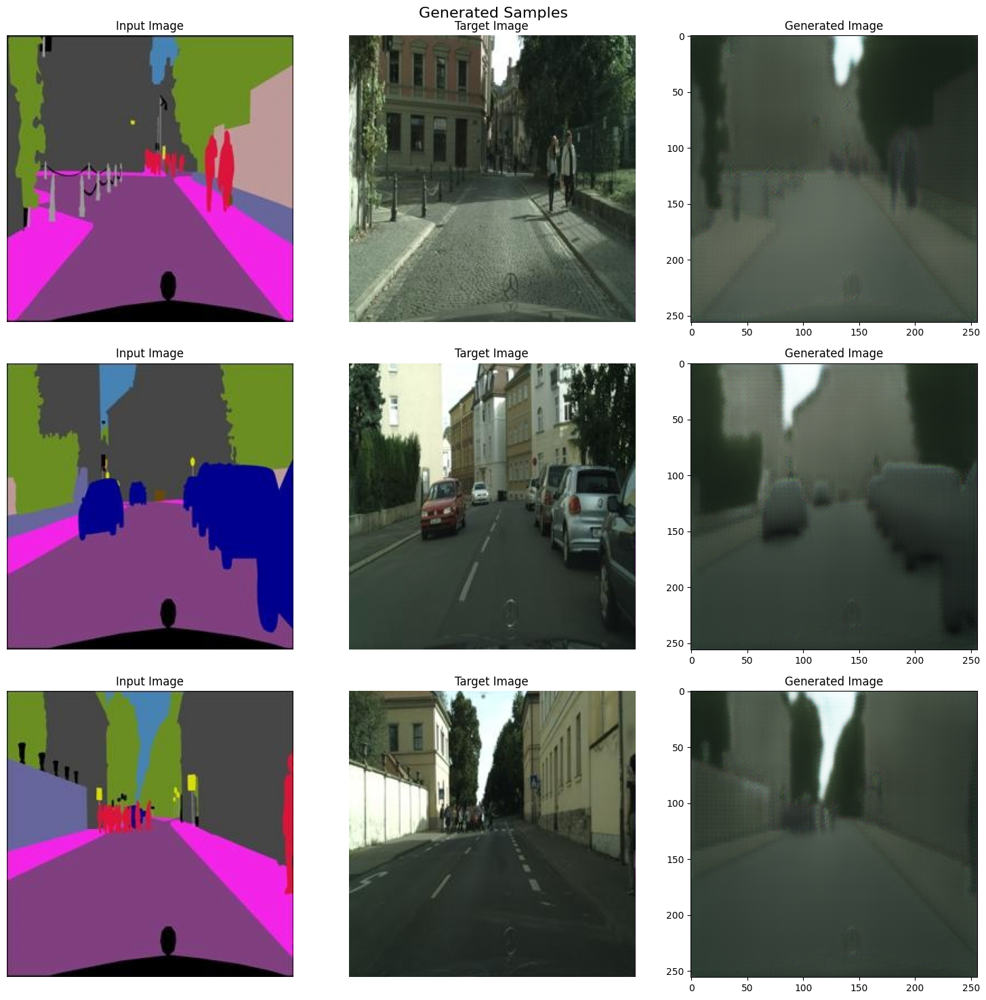

Training 11/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 11/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 11/50 | G Train Loss: 17.6148 | D Train Loss: 0.5292 | G Val Loss: 21.1837 | D Val Loss: 0.7586


Training 12/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 12/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 12/50 | G Train Loss: 17.2820 | D Train Loss: 0.5284 | G Val Loss: 21.4543 | D Val Loss: 0.7073


Training 13/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 13/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 13/50 | G Train Loss: 16.9367 | D Train Loss: 0.5957 | G Val Loss: 21.2824 | D Val Loss: 0.6752


Training 14/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 14/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 14/50 | G Train Loss: 16.5904 | D Train Loss: 0.5708 | G Val Loss: 21.4094 | D Val Loss: 0.6678


Training 15/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 15/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 15/50 | G Train Loss: 16.1955 | D Train Loss: 0.5204 | G Val Loss: 21.6600 | D Val Loss: 0.7132


Training 16/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 16/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 16/50 | G Train Loss: 15.8295 | D Train Loss: 0.5250 | G Val Loss: 22.3393 | D Val Loss: 0.6907


Training 17/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 17/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 17/50 | G Train Loss: 15.6631 | D Train Loss: 0.5268 | G Val Loss: 21.1130 | D Val Loss: 0.7094


Training 18/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 18/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 18/50 | G Train Loss: 15.3784 | D Train Loss: 0.5150 | G Val Loss: 21.4360 | D Val Loss: 0.6835


Training 19/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 19/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 19/50 | G Train Loss: 15.1045 | D Train Loss: 0.5069 | G Val Loss: 21.4287 | D Val Loss: 0.7140


Training 20/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 20/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 20/50 | G Train Loss: 14.8798 | D Train Loss: 0.5054 | G Val Loss: 21.2530 | D Val Loss: 0.7487


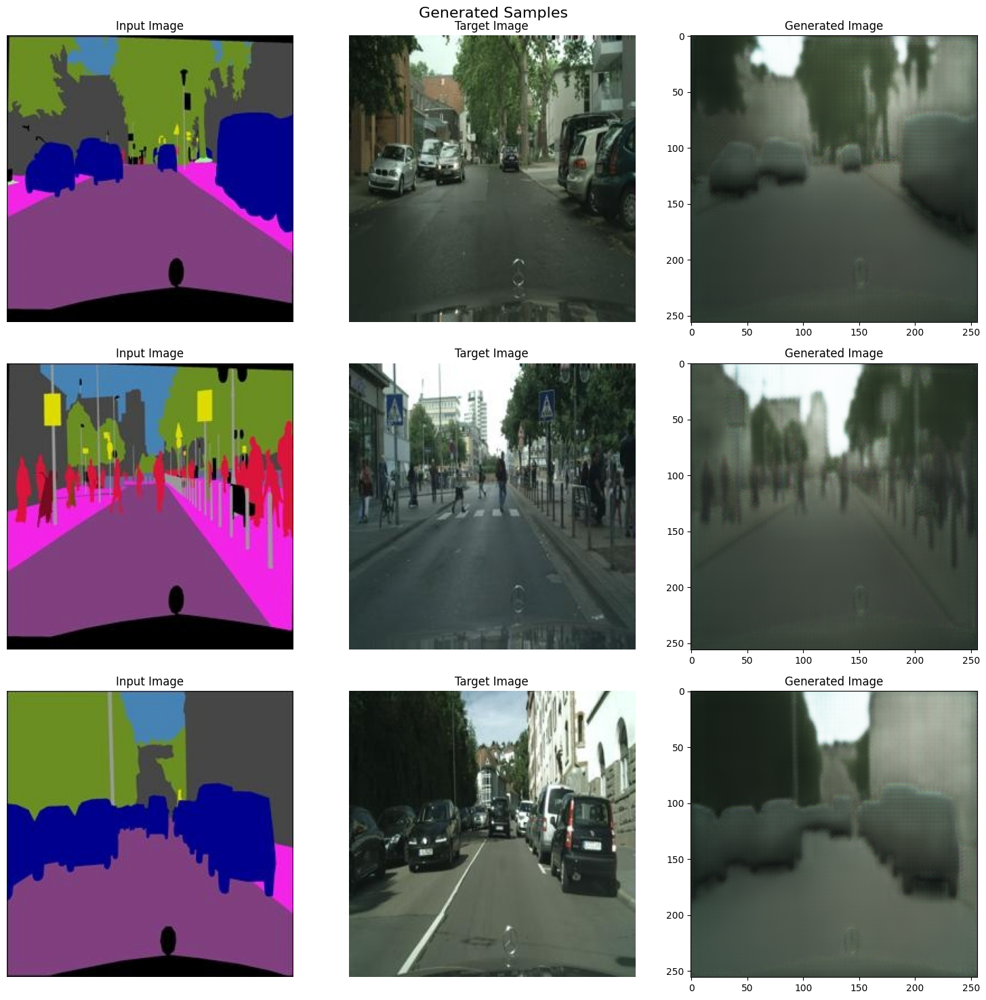

Training 21/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 21/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 21/50 | G Train Loss: 14.6418 | D Train Loss: 0.5120 | G Val Loss: 21.3451 | D Val Loss: 0.6890


Training 22/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 22/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 22/50 | G Train Loss: 14.5125 | D Train Loss: 0.5044 | G Val Loss: 21.3077 | D Val Loss: 0.7033


Training 23/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 23/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 23/50 | G Train Loss: 14.2317 | D Train Loss: 0.5041 | G Val Loss: 21.4073 | D Val Loss: 0.6892


Training 24/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 24/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 24/50 | G Train Loss: 14.0787 | D Train Loss: 0.5037 | G Val Loss: 21.2469 | D Val Loss: 0.7090


Training 25/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 25/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 25/50 | G Train Loss: 13.9072 | D Train Loss: 0.5035 | G Val Loss: 21.1447 | D Val Loss: 0.7205


Training 26/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 26/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 26/50 | G Train Loss: 13.7638 | D Train Loss: 0.5034 | G Val Loss: 21.5365 | D Val Loss: 0.7138


Training 27/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 27/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 27/50 | G Train Loss: 13.5395 | D Train Loss: 0.5034 | G Val Loss: 21.3688 | D Val Loss: 0.7181


Training 28/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 28/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 28/50 | G Train Loss: 13.4016 | D Train Loss: 0.5133 | G Val Loss: 21.4882 | D Val Loss: 0.6940


Training 29/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 29/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 29/50 | G Train Loss: 13.2210 | D Train Loss: 0.5041 | G Val Loss: 21.5978 | D Val Loss: 0.7605


Training 30/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 30/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 30/50 | G Train Loss: 13.0219 | D Train Loss: 0.5035 | G Val Loss: 21.5751 | D Val Loss: 0.7226


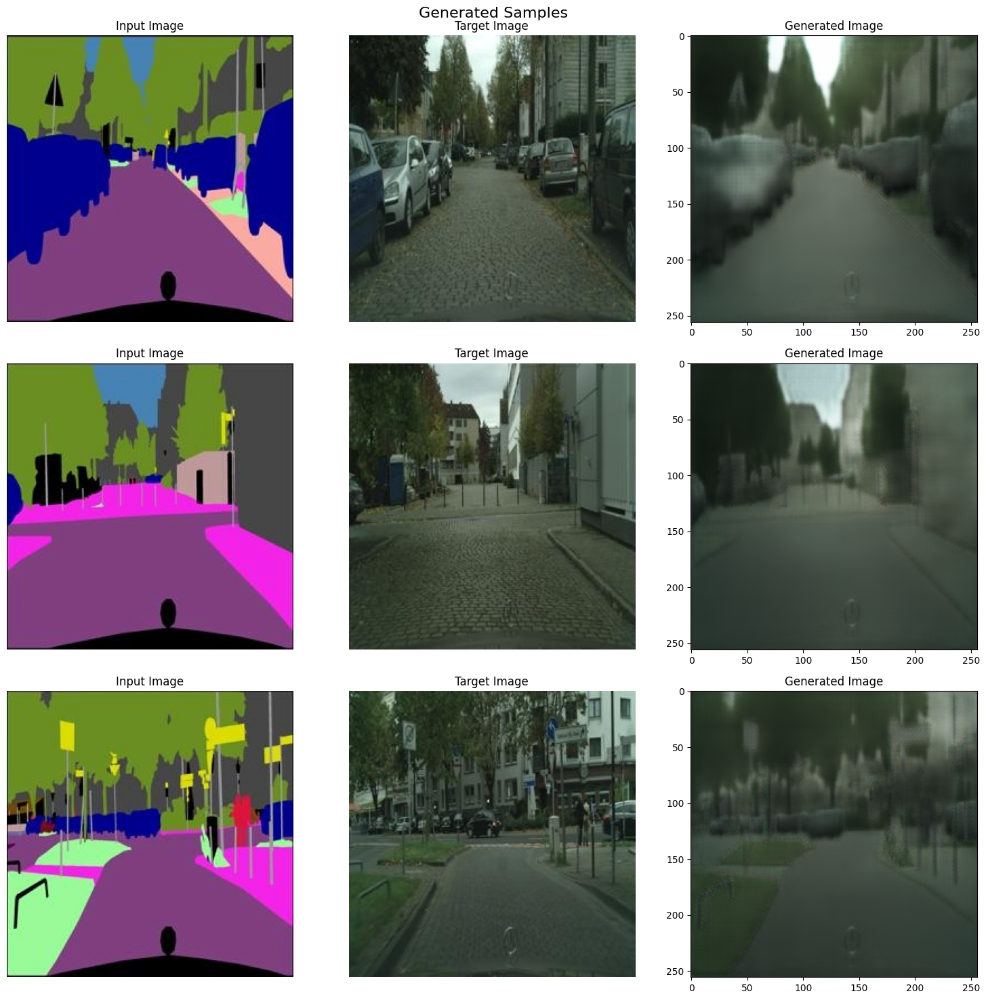

Training 31/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 31/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 31/50 | G Train Loss: 12.9153 | D Train Loss: 0.5035 | G Val Loss: 21.5197 | D Val Loss: 0.7247


Training 32/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 32/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 32/50 | G Train Loss: 12.7818 | D Train Loss: 0.5041 | G Val Loss: 21.5180 | D Val Loss: 0.7203


Training 33/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 33/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 33/50 | G Train Loss: 12.6249 | D Train Loss: 0.5034 | G Val Loss: 21.7897 | D Val Loss: 0.7185


Training 34/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 34/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 34/50 | G Train Loss: 12.4525 | D Train Loss: 0.5033 | G Val Loss: 21.5370 | D Val Loss: 0.7039


Training 35/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 35/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 35/50 | G Train Loss: 12.3406 | D Train Loss: 0.5034 | G Val Loss: 21.8513 | D Val Loss: 0.7082


Training 36/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 36/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 36/50 | G Train Loss: 12.2537 | D Train Loss: 0.5033 | G Val Loss: 21.7434 | D Val Loss: 0.7093


Training 37/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 37/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 37/50 | G Train Loss: 12.0528 | D Train Loss: 0.5033 | G Val Loss: 21.6219 | D Val Loss: 0.6966


Training 38/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 38/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 38/50 | G Train Loss: 12.0131 | D Train Loss: 0.5033 | G Val Loss: 21.4552 | D Val Loss: 0.7197


Training 39/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 39/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 39/50 | G Train Loss: 11.8272 | D Train Loss: 0.5033 | G Val Loss: 21.5725 | D Val Loss: 0.7086


Training 40/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 40/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 40/50 | G Train Loss: 11.7315 | D Train Loss: 0.5033 | G Val Loss: 21.7963 | D Val Loss: 0.6957


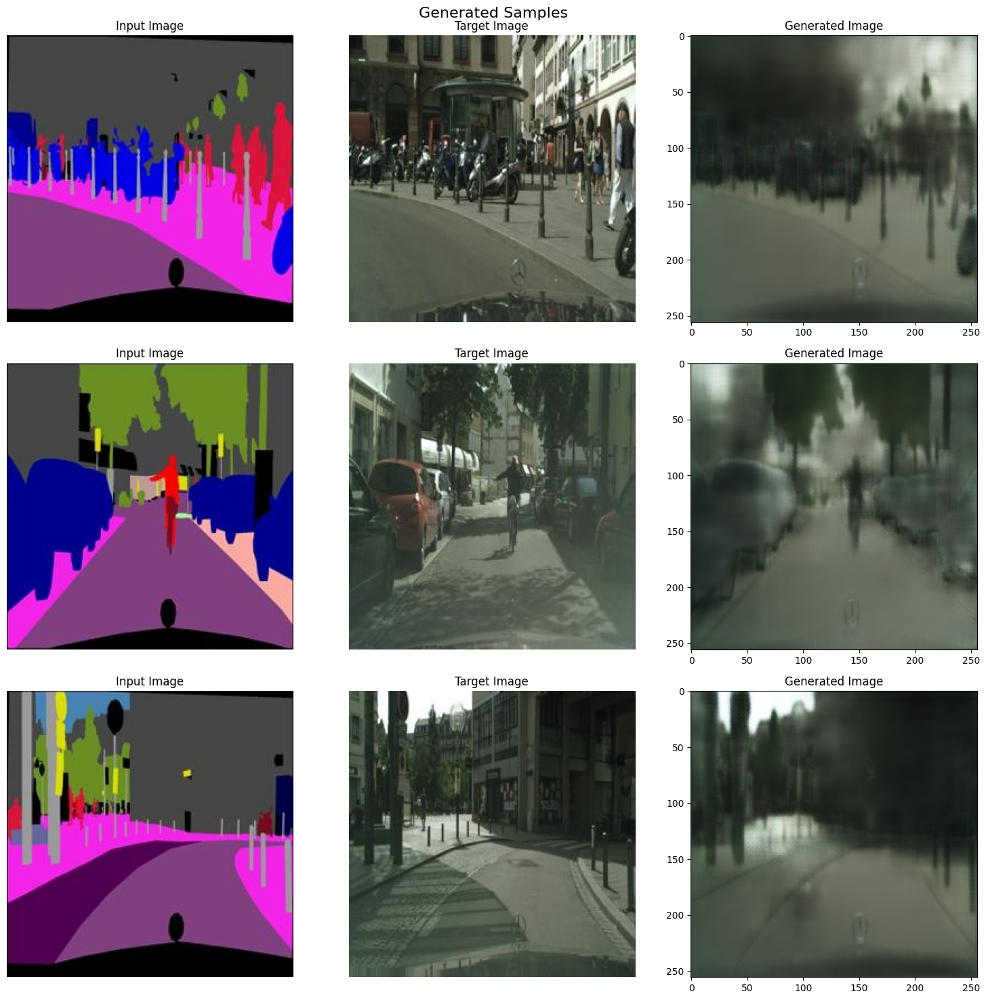

Training 41/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 41/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 41/50 | G Train Loss: 11.6268 | D Train Loss: 0.5033 | G Val Loss: 21.7545 | D Val Loss: 0.7054


Training 42/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 42/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 42/50 | G Train Loss: 11.5628 | D Train Loss: 0.5033 | G Val Loss: 21.7950 | D Val Loss: 0.6964


Training 43/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 43/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 43/50 | G Train Loss: 11.4451 | D Train Loss: 0.5033 | G Val Loss: 21.9021 | D Val Loss: 0.7069


Training 44/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 44/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 44/50 | G Train Loss: 11.3364 | D Train Loss: 0.5299 | G Val Loss: 21.7271 | D Val Loss: 0.6657


Training 45/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 45/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 45/50 | G Train Loss: 11.2639 | D Train Loss: 0.5154 | G Val Loss: 21.6577 | D Val Loss: 0.7242


Training 46/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 46/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 46/50 | G Train Loss: 11.1475 | D Train Loss: 0.5039 | G Val Loss: 21.7594 | D Val Loss: 0.6992


Training 47/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 47/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 47/50 | G Train Loss: 11.0973 | D Train Loss: 0.5034 | G Val Loss: 21.7140 | D Val Loss: 0.7124


Training 48/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 48/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 48/50 | G Train Loss: 11.0452 | D Train Loss: 0.5036 | G Val Loss: 21.9196 | D Val Loss: 0.6917


Training 49/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 49/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 49/50 | G Train Loss: 10.9270 | D Train Loss: 0.5039 | G Val Loss: 21.8475 | D Val Loss: 0.7177


Training 50/50:   0%|          | 0/93 [00:00<?, ?it/s]

Validating 50/50:   0%|          | 0/16 [00:00<?, ?it/s]

Epoch 50/50 | G Train Loss: 10.8468 | D Train Loss: 0.5033 | G Val Loss: 21.8039 | D Val Loss: 0.7120


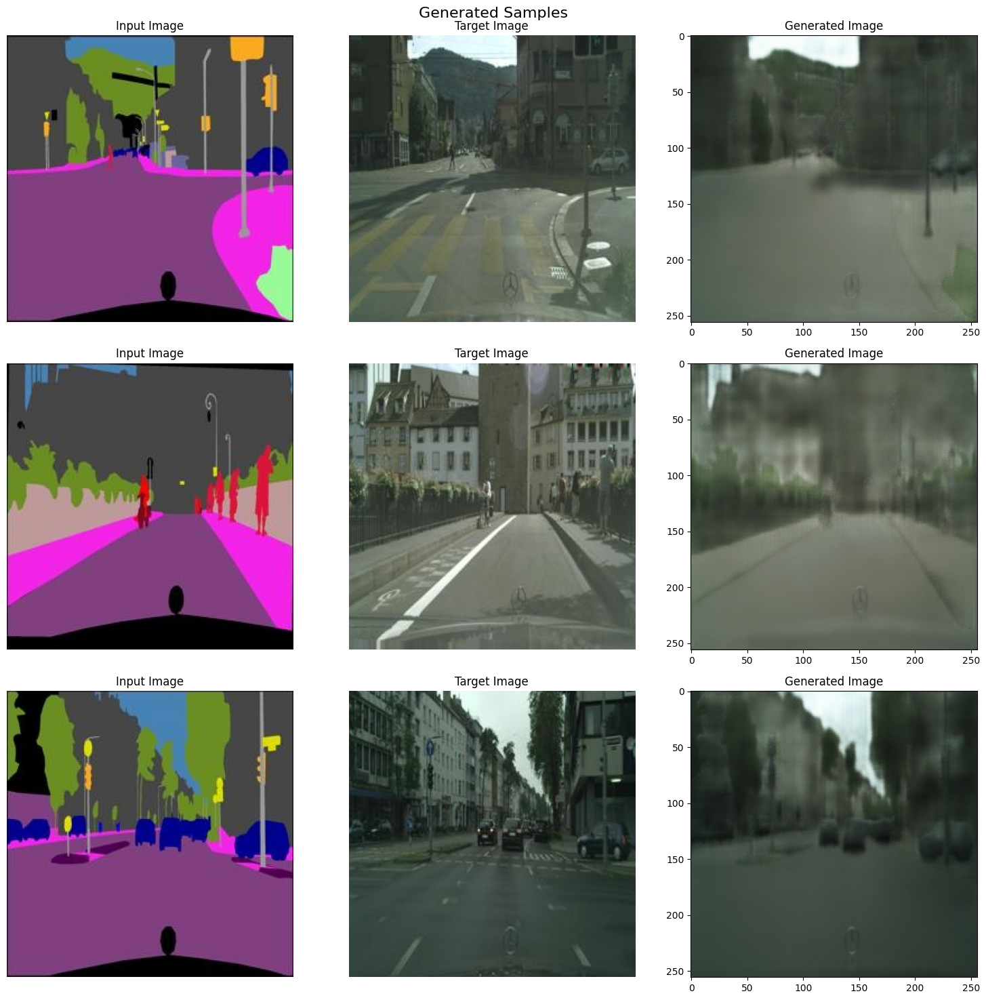

Training Completed in 7885.80 seconds.


In [22]:
# Training Pix2Pix Model

num_epochs = 50
learning_rate = 2e-4
lambda_l1 = 100
display_interval = 10

g_optimizer = optim.Adam(generator.parameters(), lr=learning_rate, betas=(0.5, 0.999))
d_optimizer = optim.Adam(discriminator.parameters(), lr=learning_rate, betas=(0.5, 0.999))

train_g_losses, train_d_losses, val_g_losses, val_d_losses = train_pix2pix(pix2pix, train_loader, val_loader, num_epochs, lambda_l1, display_interval)

## **Results**

### **Visualization**

To evaluate the Pix2Pix model's performance, we visualize its outputs by displaying 20 sample triples side by side: input segmented images, corresponding real (target) images, and the images generated by the model. We will use the previous helper function `display_generated_samples()` defined for use during training.

- **Input Image**: The segmented or conditional input fed to the generator.  
- **Target Image**: The real image (ground truth) used for comparison and training.  
- **Generated Image**: The output image created by the generator, which aims to resemble the real image.

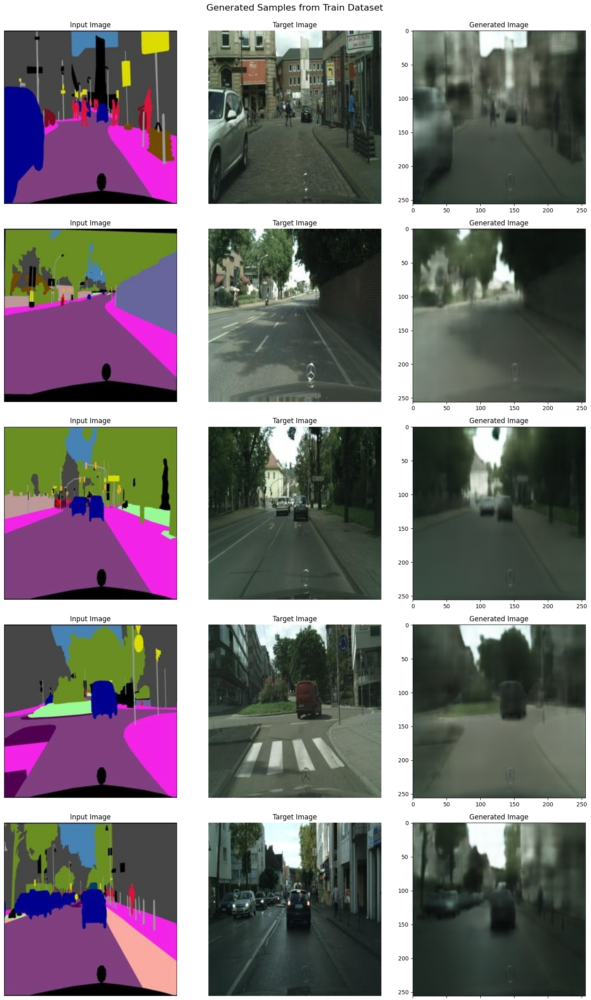

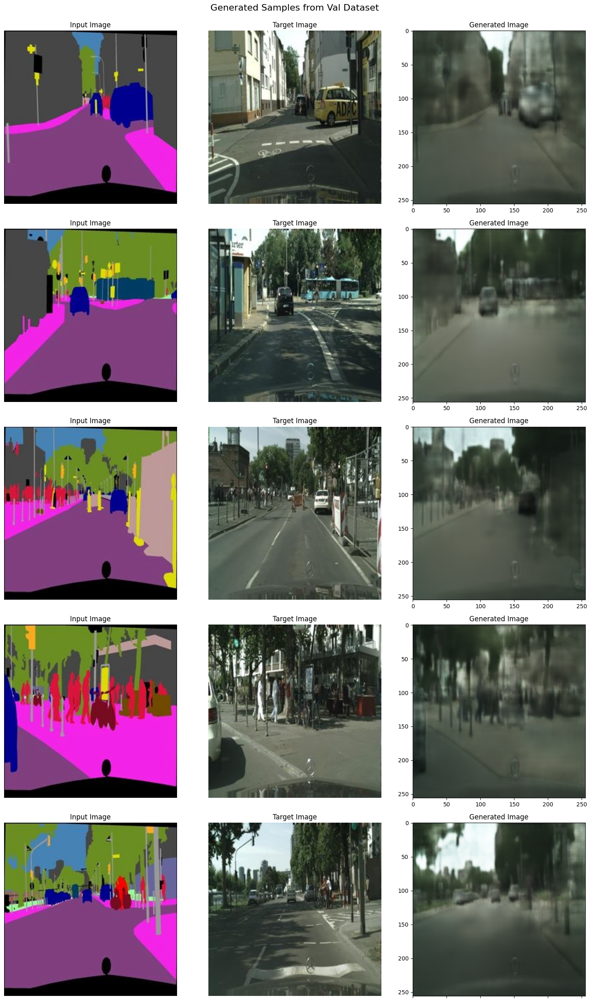

In [1]:
# Generating From 5 Samples Using Previous Function

display_generated_samples(pix2pix, train_loader, num_samples=10, title="Generated Samples from Train Dataset\n\n\n\n")
display_generated_samples(pix2pix, val_loader, num_samples=10, title="Generated Samples from Val Dataset\n\n\n\n")

#### **Analysis**

> As we can see, the generated images successfully preserve the overall structure of both the segmented and real images. However, the finer details appear blurry compared to the target real images, despite the model's faithfulness to the general color scheme and density of features.

> Interestingly, the progression of blurriness can be observed throughout the training process. In the initial epochs, the model produces clearer shapes but lacks finer details. As training progresses, the model transitions from capturing the shared structure between the segmented and real images to identifying and learning the finer details of the target image. The blurriness indicates that the model is still in the early stages of learning to generate these finer details and would continue to improve with additional epochs (consistent with the paper's `200-epoch` run). It is also important to note that batch size has a significant impact on the results: a batch size of `32` reduces the number of weight updates while increasing training speed, which hinders performance. Reducing the batch size to `16`, `10`, or even `4` would yield significantly better generation results.

> A final note must also be made on analysing the degree of the trained model's consistency. The model appears generally stable (implying a stable learning process), though it does tend to produce better results for simpler images with less variation in color and detail density. This appears to be a direct result of the training process: the model first learns the overall image structure, aided by the simple and clearly outlined segmented images, and then focuses on capturing the finer details of the real images.

### **Cost Function Analysis**

To quantitatively assess the training process, we plot the Generator and Discriminator loss curves over the training and validating epochs. We will define a new function for easier application and use the previously calculated `train_g_losses`, `train_d_losses`, `val_g_loss`, and `val_d_loss`.


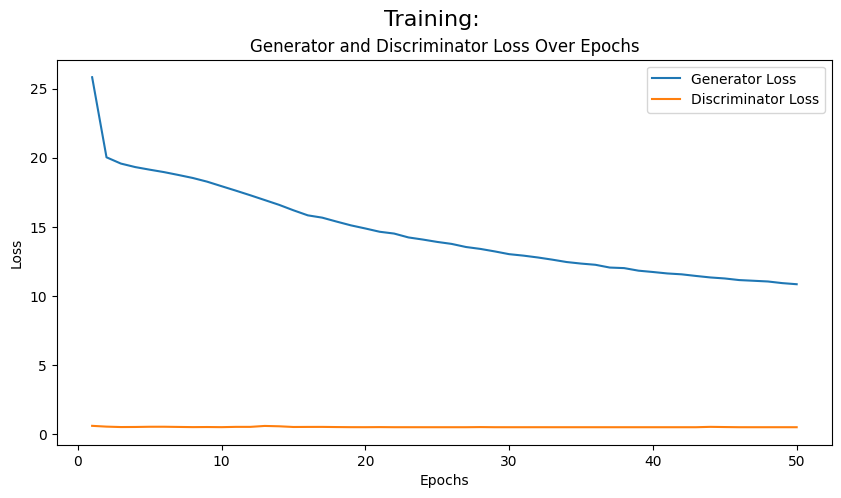

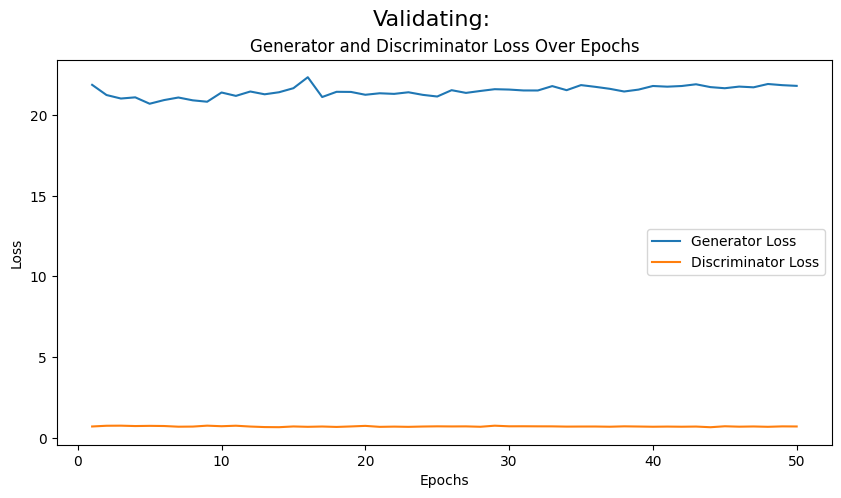

In [4]:
# Plotting Discriminator and Generator Cost Function Losses

def plot_losses(g_losses, d_losses, title="Loss Analysis:"):

    plt.figure(figsize=(10, 5))
    plt.suptitle(title, fontsize=16)

    plt.plot(range(1, len(g_losses) + 1), g_losses, label="Generator Loss")
    plt.plot(range(1, len(d_losses) + 1), d_losses, label="Discriminator Loss")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.title("Generator and Discriminator Loss Over Epochs")
    plt.legend()
    plt.show()

plot_losses(train_g_losses, train_d_losses, title="Training:")
plot_losses(val_g_losses, val_d_losses, title="Validating:")

#### **Analysis**

>


**Train Generator Loss (`train_g_losses`)**:
- The generator loss shows a clear **downward trend** from ~25.82 (Epoch 1) to ~10.85 (Epoch 50), indicating that the generator is improving over time.
- The steady decrease signifies that the generator learns to generate data closer to the real distribution.

**Train Discriminator Loss (`train_d_losses`)**:
- The discriminator loss decreases initially but **plateaus around 0.5**, which is a common trend when the discriminator and generator reach a balance.
- Around Epoch 13, there is a slight increase (0.5957) but it stabilizes shortly after.

**Validation Generator Loss (`val_g_losses`)**:
- The validation generator loss decreases initially but **fluctuates slightly after Epoch 15**, around ~21.4 to ~21.8.
- This fluctuation and even increase may indicate the model is still far from capturing the general distribution and producing desired output for data outside of its training set.

**Validation Discriminator Loss (`val_d_losses`)**:
- The validation discriminator loss fluctuates between **0.67 and 0.76**, showing a pattern similar to the train discriminator loss.
- The loss values suggest that the discriminator is neither completely overpowering the generator nor failing to learn.

<br/>

Generally, it can be seen that the discriminator in both training and validation maintains a balance (not too strong to overpower the generator, and not too weak to completely fail) which shows a successfull minmaxing game between $D$ and $G$ (i.e., stabilizing around `0.5–0.7` and indicating equilibrium without overpowering each other).

Additionally, the generator loss decreases consistently during training, showing progress in learning the target data distribution with a gradual decline that implies stable learning; meanwhile, despite the generator's validation losses fluctuating slightly after 15 epochs, it remains within a narrow range, suggesting no severe overfitting.